<a href="https://colab.research.google.com/github/AlexWortega/Collab_experement/blob/main/ruPersona.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!git clone https://github.com/huggingface/transfer-learning-conv-ai

Cloning into 'transfer-learning-conv-ai'...
remote: Enumerating objects: 132, done.
remote: Total 132 (delta 0), reused 0 (delta 0), pack-reused 132
Receiving objects: 100% (132/132), 56.09 KiB | 1.19 MiB/s, done.
Resolving deltas: 100% (71/71), done.


In [ ]:
%%time
import requests
r = requests.get('http://46.17.97.44:5000/push/?text=как срать не снимая&temp=0.5')

CPU times: user 5.33 ms, sys: 248 µs, total: 5.58 ms
Wall time: 544 ms


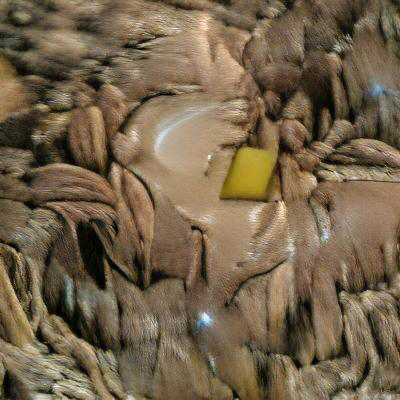

In [ ]:
import requests
r = requests.post('http://46.17.101.202:8080/v2/models/kfserving-default/infer', json={'text':'Полет из афгана', 'iter': 200, 'size':400})
from PIL import Image
from io import BytesIO
import numpy as np
import base64
from io import BytesIO
#функция которая декодирует base64 изображение
def decode_img(img_b64):
    bin_img = base64.b64decode(img_b64)
    buff = BytesIO(bin_img)
    img = np.array(Image.open(buff))
    return img
Image.fromarray(decode_img(r.json()['image']))

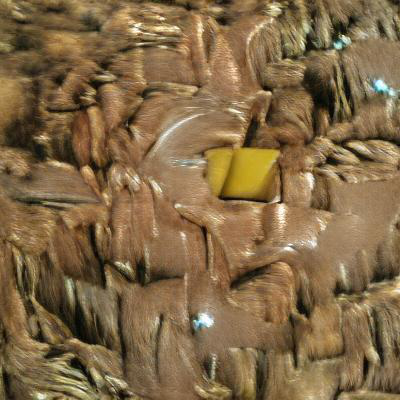

In [ ]:
import requests
r = requests.post('http://46.17.101.202:8080/v2/models/kfserving-default/infer', json={'text':'Полет из афгана', 'iter': 100, 'size':400})
from PIL import Image
from io import BytesIO
import numpy as np
import base64
from io import BytesIO
#функция которая декодирует base64 изображение
def decode_img(img_b64):
    bin_img = base64.b64decode(img_b64)
    buff = BytesIO(bin_img)
    img = np.array(Image.open(buff))
    return img
Image.fromarray(decode_img(r.json()['image']))

In [ ]:
import torch
torch.__version__

'1.9.0+cu102'

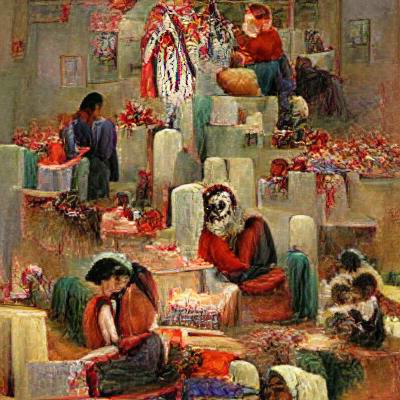

In [ ]:
Image.fromarray(decode_img(r.json()['image']))

In [ ]:
!pip install pytorch-ignite
!pip install transformers
!pip install tensorboardX==1.8
!pip install tensorflow 

     |████████████████████████████████| 232 kB 8.2 MB/s 
     |████████████████████████████████| 2.6 MB 8.3 MB/s 
     |████████████████████████████████| 636 kB 49.3 MB/s 
     |████████████████████████████████| 3.3 MB 44.5 MB/s 
     |████████████████████████████████| 895 kB 33.8 MB/s 
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
     |████████████████████████████████| 216 kB 8.2 MB/s 


In [ ]:
!wget https://tlk.s3.yandex.net/dataset/TlkPersonaChatRus.zip
!unzip TlkPersonaChatRus.zip

--2021-08-23 10:48:11--  https://tlk.s3.yandex.net/dataset/TlkPersonaChatRus.zip
Resolving tlk.s3.yandex.net (tlk.s3.yandex.net)... 93.158.134.158, 2a02:6b8::2:158
Connecting to tlk.s3.yandex.net (tlk.s3.yandex.net)|93.158.134.158|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 6139432 (5.9M) [application/zip]
Saving to: ‘TlkPersonaChatRus.zip’

TlkPersonaChatRus.z 100%[===================>]   5.85M  4.05MB/s    in 1.4s    

2021-08-23 10:48:14 (4.05 MB/s) - ‘TlkPersonaChatRus.zip’ saved [6139432/6139432]



In [ ]:
!unzip TlkPersonaChatRus.zip

Archive:  TlkPersonaChatRus.zip
   creating: TlkPersonaChatRus/
  inflating: TlkPersonaChatRus/dialogues.tsv  
  inflating: TlkPersonaChatRus/readme_TlkPersonaChatRus.txt  
  inflating: TlkPersonaChatRus/profiles.tsv  


In [ ]:
!git lfs install
!git clone https://huggingface.co/Grossmend/rudialogpt3_medium_based_on_gpt2
# if you want to clone without large files – just their pointers
# prepend your git clone with the following env var:


git: 'lfs' is not a git command. See 'git --help'.

The most similar command is
	log
Cloning into 'rudialogpt3_medium_based_on_gpt2'...
remote: Enumerating objects: 39, done.
remote: Counting objects: 100% (39/39), done.
remote: Compressing objects: 100% (38/38), done.
remote: Total 39 (delta 16), reused 0 (delta 0)
Unpacking objects: 100% (39/39), done.


In [ ]:
import pandas as pd
df = pd.read_csv('TlkPersonaChatRus/dialogues.tsv',sep='\t')

In [ ]:
df['dialogue'][0]

'<span class=participant_2>Пользователь 2: Привет) расскажи о себе</span><br /><span class=participant_1>Пользователь 1: Привет) под вкусный кофеек настроение поболтать появилось<br />)</span><br /><span class=participant_2>Пользователь 2: Что читаешь? Мне нравится классика</span><br /><span class=participant_2>Пользователь 2: Я тоже люблю пообщаться</span><br /><span class=participant_1>Пользователь 1: Люблю животных, просто обожаю, как и свою работу)</span><br /><span class=participant_1>Пользователь 1: Я фантастику люблю</span><br /><span class=participant_2>Пользователь 2: А я выращиваю фиалки</span><br /><span class=participant_2>Пользователь 2: И веду здоровый и активный образ жизни!</span><br /><span class=participant_1>Пользователь 1: Ух ты, интересно.</span><br /><span class=participant_2>Пользователь 2: Ты случайно не принц на белом коне? Я его очень жду<br />..</span><br /><span class=participant_1>Пользователь 1: А у меня из хобби каждую неделю тусить с моим лучшим<br />дру

In [ ]:
(df['dialogue'])[0].replace('<span class=participant_2>','').replace('</span><br />',' ').replace('<span class=participant_1>','').replace('<br /',' ').replace('>)',' ').replace('>',' ').replace(')',' ')

'Пользователь 2: Привет  расскажи о себе Пользователь 1: Привет  под вкусный кофеек настроение поболтать появилось   Пользователь 2: Что читаешь? Мне нравится классика Пользователь 2: Я тоже люблю пообщаться Пользователь 1: Люблю животных, просто обожаю, как и свою работу  Пользователь 1: Я фантастику люблю Пользователь 2: А я выращиваю фиалки Пользователь 2: И веду здоровый и активный образ жизни! Пользователь 1: Ух ты, интересно. Пользователь 2: Ты случайно не принц на белом коне? Я его очень жду  .. Пользователь 1: А у меня из хобби каждую неделю тусить с моим лучшим  другом  '

In [ ]:
bos = tokenizer.bos_token
eos = tokenizer.eos_token
speaker1 = '<speaker1>'
speaker2 = '<speaker2>'
data = []
for persona1,persona2,dialog in zip(df['persona_1_profile'],df['persona_2_profile'],df['dialogue']):
  dialog=dialog.replace('<br/>','')
  d= bos + speaker1 + persona1 + speaker2 + persona2 + dialog.replace('<span class=participant_2>Пользователь 2:',speaker2).replace('<span class=participant_1>Пользователь 1:',speaker1).replace('<span class=participant_1>','').replace('<br /></span>',' ').replace(')',' ').replace('</span>','').replace('<br />',' ')
  data+=[d.replace('<br />','').replace('<span class=participant_1>','').replace('<span class=participant_2>','').replace('</span>','')]


In [ ]:
len(data)

10013

In [ ]:
prepared = data
val = prepared[int(len(prepared)/2):]

train = prepared[:int(len(prepared)/2)]

with open("val.txt", "w") as txt_file:
    for line in val:
        txt_file.write("".join(line) + "\n")
with open("train.txt", "w") as txt_file:
    for line in train:
        txt_file.write("".join(line) + "\n")

In [ ]:
from transformers import AutoTokenizer, AutoModelWithLMHead, GPT2Tokenizer
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer,GPT2LMHeadModel

tokenizer = GPT2Tokenizer.from_pretrained("Grossmend/rudialogpt3_medium_based_on_gpt2",truncation=True)
model = GPT2LMHeadModel.from_pretrained("Grossmend/rudialogpt3_medium_based_on_gpt2")


Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


In [ ]:
ATTR_TO_SPECIAL_TOKEN = {'bos_token': '<bos>', 'eos_token': '<eos>', 'pad_token': '<pad>',
                         'additional_special_tokens': ['<speaker1>', '<speaker2>']}

tokenizer.add_special_tokens(ATTR_TO_SPECIAL_TOKEN)

4

In [ ]:
tokenizer

PreTrainedTokenizerFast(name_or_path='Grossmend/rudialogpt3_medium_based_on_gpt2', vocab_size=50257, model_max_len=1000000000000000019884624838656, is_fast=True, padding_side='right', special_tokens={'bos_token': '<bos>', 'eos_token': '<eos>', 'unk_token': '<unk>', 'pad_token': '<pad>', 'mask_token': '<mask>', 'additional_special_tokens': ['<speaker1>', '<speaker2>']})

In [ ]:
from transformers import TextDataset,DataCollatorForLanguageModeling

train_path = '/content/train.txt'
test_path = '/content/val.txt'


def load_dataset(train_path,test_path,tokenizer):
    train_dataset = TextDataset(
          tokenizer=tokenizer,
          file_path=train_path,
          block_size=128)
     
    test_dataset = TextDataset(
          tokenizer=tokenizer,
          file_path=test_path,
          block_size=128)   
    
    data_collator = DataCollatorForLanguageModeling(
        tokenizer=tokenizer, mlm=False,
    )
    return train_dataset,test_dataset,data_collator

train_dataset,test_dataset,data_collator = load_dataset(train_path,test_path,tokenizer)

/usr/local/lib/python3.7/dist-packages/transformers/data/datasets/language_modeling.py:58: FutureWarning: This dataset will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/master/examples/pytorch/language-modeling/run_mlm.py
  FutureWarning,


In [ ]:
trainer.train()

***** Running training *****
  Num examples = 10907
  Num Epochs = 5
  Instantaneous batch size per device = 32
  Total train batch size (w. parallel, distributed & accumulation) = 32
  Gradient Accumulation steps = 1
  Total optimization steps = 1705


RuntimeError: ignored

In [ ]:
from transformers import Trainer, TrainingArguments, AutoModelWithLMHead




max_history = 4
train_batch_size = 4
valid_batch_size = 4
gradient_accumulation_steps = 8
lr = 6.25e-5
lm_coef = 1.0
mc_coef = 1.0
max_norm = 1.0
n_epochs = 3
n_epochs = 5
personality_permutations = 1 
eval_before_start = 'store_true'


local_rank = -1

training_args = TrainingArguments(
    output_dir="./Raya_m", #The output directory
    overwrite_output_dir=True, #overwrite the content of the output directory
    num_train_epochs=5, # number of training epochs
    per_device_train_batch_size=32, # batch size for training
    per_device_eval_batch_size=64,  # batch size for evaluation
    eval_steps = 400, # Number of update steps between two evaluations.
    save_steps=200, # after # steps model is saved 
    learning_rate = 6.25e-5,
    warmup_steps=500,# number of warmup steps for learning rate scheduler
    prediction_loss_only=True,
    )


trainer = Trainer(
    model = model,
    args = training_args,
    data_collator = data_collator,
    train_dataset = train_dataset,
    eval_dataset = test_dataset
)

In [ ]:
The default value for the training argument `--report_to` will change in v5 (from all installed integrations to none). In v5, you will need to use `--report_to all` to get the same behavior as now. You should start updating your code and make this info disappear :-).

In [ ]:
model.lr_find(start_lr=1e-5,optimizer_type='lamb')

In [ ]:
!nvidia-smi

Mon Aug 23 10:50:51 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.57.02    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   44C    P0    35W / 250W |   2779MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
trainer.save_model('./data')

In [ ]:
tokenizer.save_pretrained('./data')

('./data/tokenizer_config.json',
 './data/special_tokens_map.json',
 './data/vocab.json',
 './data/merges.txt',
 './data/added_tokens.json')

In [ ]:
data[0]

'<bos><speaker1>У меня любимая работа.Я уважаю людей.У меня есть животное.У меня хороший друг.Я люблю кофе.<speaker2>Ищу принца.Веду активный образ жизни.Люблю читать классику.Выращиваю фиалки.Люблю общение.<speaker2> Привет  расскажи о себе <speaker1> Привет  под вкусный кофеек настроение поболтать появилось   <speaker2> Что читаешь? Мне нравится классика <speaker2> Я тоже люблю пообщаться <speaker1> Люблю животных, просто обожаю, как и свою работу  <speaker1> Я фантастику люблю <speaker2> А я выращиваю фиалки <speaker2> И веду здоровый и активный образ жизни! <speaker1> Ух ты, интересно. <speaker2> Ты случайно не принц на белом коне? Я его очень жду .. <speaker1> А у меня из хобби каждую неделю тусить с моим лучшим другом  '

In [ ]:
(df['dialogue'])[0]

'<span class=participant_2>Пользователь 2: Привет) расскажи о себе</span><br /><span class=participant_1>Пользователь 1: Привет) под вкусный кофеек настроение поболтать появилось<br />)</span><br /><span class=participant_2>Пользователь 2: Что читаешь? Мне нравится классика</span><br /><span class=participant_2>Пользователь 2: Я тоже люблю пообщаться</span><br /><span class=participant_1>Пользователь 1: Люблю животных, просто обожаю, как и свою работу)</span><br /><span class=participant_1>Пользователь 1: Я фантастику люблю</span><br /><span class=participant_2>Пользователь 2: А я выращиваю фиалки</span><br /><span class=participant_2>Пользователь 2: И веду здоровый и активный образ жизни!</span><br /><span class=participant_1>Пользователь 1: Ух ты, интересно.</span><br /><span class=participant_2>Пользователь 2: Ты случайно не принц на белом коне? Я его очень жду<br />..</span><br /><span class=participant_1>Пользователь 1: А у меня из хобби каждую неделю тусить с моим лучшим<br />дру

In [ ]:
df['persona_1_profile'][0]

'<span class=participant_1>У меня любимая работа.<br />Я уважаю людей.<br />У меня есть животное.<br />У меня хороший друг.<br />Я люблю кофе.<br /></span>'

In [ ]:
import pandas as pd
df = pd.read_csv('/content/TlkPersonaChatRus/profiles.tsv',sep='\t')
df.head()

,characteristic_1,characteristic_2,characteristic_3,characteristic_4,characteristic_5
У меня любимая работа.,Я уважаю людей.,У меня есть животное.,У меня хороший друг.,Я люблю кофе.,NaN
Я работаю учителем,У меня есть собака,Я люблю петь,Я живу сама,Я люблю цветы,NaN
Я купила дом,Я бегаю по утрам,Я работаю на работе,Я поеду в отпуск,Я люблю арбуз,NaN
я врач и женат,у меня трое детей,не люблю свою работу,нравиться ездить на велосипеде,люблю пиво,NaN
Я школьница.,Я ещё учусь.,Но я мечтаю работать.,Я обожаю родителей.,И не люблю учиться.,NaN


In [ ]:
df['characteristic_1'][0]

'Я уважаю людей.'

In [ ]:
#original hiant set
!wget https://s3.amazonaws.com/datasets.huggingface.co/personachat/personachat_self_original.json

--2021-08-18 12:12:41--  https://s3.amazonaws.com/datasets.huggingface.co/personachat/personachat_self_original.json
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.216.244.246
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.216.244.246|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 209850483 (200M) [application/json]
Saving to: ‘personachat_self_original.json’

personachat_self_or 100%[===================>] 200.13M  47.7MB/s    in 4.2s    

2021-08-18 12:12:46 (47.4 MB/s) - ‘personachat_self_original.json’ saved [209850483/209850483]



In [ ]:
import pandas as pd
import json
import os




with open('/content/personachat_self_original.json') as json_data:
    data = json.load(json_data)


g = pd.DataFrame.from_dict(data, orient='index')
g = g.transpose()

In [ ]:
g.head()

,train,valid
0,"{'personality': ['i like to remodel homes .', ...",{'personality': ['i read twenty books a year ....
1,"{'personality': ['my mom is my best friend .',...","{'personality': ['i have two dogs .', 'i like ..."
2,{'personality': ['i had a gig at local theater...,{'personality': ['i love disneyland and mickey...
3,"{'personality': ['i'm very athletic .', 'i wea...",{'personality': ['i love to drink fancy tea .'...
4,{'personality': ['i am primarily a meat eater ...,"{'personality': ['i'm a little girl .', 'i've ..."


In [ ]:
g['train'][0]

In [ ]:
!gdown https://drive.google.com/uc?id=1l0iOp_YHE1y7_gwFntvUAnr7OqAYt3V2
!unzip /content/persona_GPT_small.zip

Downloading...
From: https://drive.google.com/uc?id=1l0iOp_YHE1y7_gwFntvUAnr7OqAYt3V2
To: /content/persona_GPT_small.zip
463MB [00:04, 114MB/s]


In [ ]:
!unzip /content/persona_GPT_small.zip

Archive:  /content/persona_GPT_small.zip
   creating: content/data/
  inflating: content/data/merges.txt  
  inflating: content/data/config.json  
  inflating: content/data/pytorch_model.bin  
  inflating: content/data/training_args.bin  
  inflating: content/data/tokenizer_config.json  
  inflating: content/data/added_tokens.json  
  inflating: content/data/vocab.json  
  inflating: content/data/special_tokens_map.json  


In [ ]:
import os
import math
import logging
from pprint import pformat

from argparse import ArgumentParser

from collections import defaultdict

from itertools import chain

import torch
from torch.nn.parallel import DistributedDataParallel
from torch.utils.data import DataLoader, TensorDataset

from ignite.engine import Engine, Events

from ignite.handlers import ModelCheckpoint, global_step_from_engine

from ignite.metrics import Accuracy, Loss, MetricsLambda, RunningAverage

from ignite.contrib.handlers import ProgressBar, PiecewiseLinear

from ignite.contrib.handlers.tensorboard_logger import TensorboardLogger, OutputHandler, OptimizerParamsHandler

from transformers import (AdamW, OpenAIGPTDoubleHeadsModel, OpenAIGPTTokenizer,
                                  GPT2DoubleHeadsModel, GPT2Tokenizer, WEIGHTS_NAME, CONFIG_NAME)





dataset_path = ''
dataset_cache = './'
logger = logging.getLogger(dataset_cache)
model_checkpoint = "sberbank-ai/rugpt3small_based_on_gpt2"
num_candidates = 2

max_history = 4
train_batch_size = 4
valid_batch_size = 4
gradient_accumulation_steps = 8
lr = 6.25e-5
lm_coef = 1.0
mc_coef = 1.0
max_norm = 1.0
n_epochs = 3
n_epochs = 3
personality_permutations = 1 
eval_before_start = 'store_true'
device = 'cuda'
fp16 = ''
local_rank = -1
    
   

    # logging is set to INFO (resp. WARN) for main (resp. auxiliary) process. logger.info => log main process only, logger.warning => log all processes
logging.basicConfig(level=logging.INFO if local_rank in [-1, 0] else logging.WARN)

logger.warning("Running process %d", local_rank)  # This is a logger.warning: it will be printed by all distributed processes
    #logger.info("Arguments: %s", pformat(args))

    # Initialize distributed training if needed
distributed = (local_rank != -1)


logger.info("Prepare tokenizer, pretrained model and optimizer.")
tokenizer_class = GPT2Tokenizer if "gpt2" in model_checkpoint else OpenAIGPTTokenizer # cant use Autotokenizer because checkpoint could be a Path
tokenizer = tokenizer


model_class = GPT2DoubleHeadsModel if "gpt2" in model_checkpoint else OpenAIGPTDoubleHeadsModel

model = model_class.from_pretrained(model_checkpoint)

model.to(device)
    # Add special tokens if they are not already added
add_special_tokens_(model, tokenizer)

INFO:./:Prepare tokenizer, pretrained model and optimizer.
INFO:filelock:Lock 140300789009936 acquired on /root/.cache/huggingface/transformers/06f48b6b3173390d047e15d691fda67ae4ea7733a5eea4b6e0115f5099c4e700.b5cdfa39c63384f94159c36bc9042660c747cea5cf520b43d543bd2c68b3164d.lock


Downloading:   0%|          | 0.00/608 [00:00<?, ?B/s]

INFO:filelock:Lock 140300789009936 released on /root/.cache/huggingface/transformers/06f48b6b3173390d047e15d691fda67ae4ea7733a5eea4b6e0115f5099c4e700.b5cdfa39c63384f94159c36bc9042660c747cea5cf520b43d543bd2c68b3164d.lock
INFO:filelock:Lock 140300726441808 acquired on /root/.cache/huggingface/transformers/df2b64a4c86a349ba84354d85b7117b106f2b87085c9bb54cde70d3751907c45.4e3da19dd8adaa6d6a9804bfd45d2dcf17ba544de445847443ef1816bfa3d693.lock


Downloading:   0%|          | 0.00/551M [00:00<?, ?B/s]

INFO:filelock:Lock 140300726441808 released on /root/.cache/huggingface/transformers/df2b64a4c86a349ba84354d85b7117b106f2b87085c9bb54cde70d3751907c45.4e3da19dd8adaa6d6a9804bfd45d2dcf17ba544de445847443ef1816bfa3d693.lock
Some weights of GPT2DoubleHeadsModel were not initialized from the model checkpoint at sberbank-ai/rugpt3small_based_on_gpt2 and are newly initialized: ['multiple_choice_head.summary.weight', 'multiple_choice_head.summary.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


AttributeError: ignored

In [ ]:
def get_data_loaders(dataset_path, dataset_cache, tokenizer, num_candidates, max_history, distributed, train_batch_size):
    """ Prepare the dataset for training and evaluation """
    #personachat = get_dataset(tokenizer, dataset_path, dataset_cache)

    logger.info("Build inputs and labels")

    datasets = {"train": defaultdict(list), "valid": defaultdict(list)}

    for dataset_name, dataset in personachat.items():

        num_candidates = len(dataset[0]["utterances"][0]["candidates"])

        if num_candidates > 0 and dataset_name == 'train':
            num_candidates = min(num_candidates, num_candidates)

        for dialog in dataset:
            persona = dialog["personality"].copy()

            for _ in range(personality_permutations):

                for utterance in dialog["utterances"]:
                    history = utterance["history"][-(2*max_history+1):]

                    for j, candidate in enumerate(utterance["candidates"][-num_candidates:]):

                        lm_labels = bool(j == num_candidates-1)

                        instance = build_input_from_segments(persona, history, candidate, tokenizer, lm_labels)

                        for input_name, input_array in instance.items():
                            datasets[dataset_name][input_name].append(input_array)

                    datasets[dataset_name]["mc_labels"].append(num_candidates - 1)

                    datasets[dataset_name]["n_candidates"] = num_candidates
                persona = [persona[-1]] + persona[:-1]  # permuted personalities

    logger.info("Pad inputs and convert to Tensor")
    tensor_datasets = {"train": [], "valid": []}
    
    for dataset_name, dataset in datasets.items():
      
        dataset = pad_dataset(dataset, padding=tokenizer.convert_tokens_to_ids(SPECIAL_TOKENS[-1]))
       
        for input_name in MODEL_INPUTS:
            tensor = torch.tensor(dataset[input_name])
            if input_name != "mc_labels":
                tensor = tensor.view((-1, datasets[dataset_name]["n_candidates"]) + tensor.shape[1:])
            tensor_datasets[dataset_name].append(tensor)

    logger.info("Build train and validation dataloaders")

    train_dataset, valid_dataset = TensorDataset(*tensor_datasets["train"]), TensorDataset(*tensor_datasets["valid"])
    
    train_sampler = torch.utils.data.distributed.DistributedSampler(train_dataset) if distributed else None
    valid_sampler = torch.utils.data.distributed.DistributedSampler(valid_dataset) if distributed else None
    train_loader = DataLoader(train_dataset, sampler=train_sampler, batch_size=train_batch_size, shuffle=(not distributed))
    valid_loader = DataLoader(valid_dataset, sampler=valid_sampler, batch_size=valid_batch_size, shuffle=False)

    logger.info("Train dataset (Batch, Candidates, Seq length): {}".format(train_dataset.tensors[0].shape))
    logger.info("Valid dataset (Batch, Candidates, Seq length): {}".format(valid_dataset.tensors[0].shape))
    return train_loader, valid_loader, train_sampler, valid_sampler

In [ ]:
type(personachat)

dict

In [ ]:
logger.info("Build inputs and labels")

datasets = {"train": defaultdict(list), "valid": defaultdict(list)}
personachat = get_dataset(tokenizer, '/content/personachat_self_original.json', './')


INFO:./:Build inputs and labels
INFO:./:Download dataset from /content/personachat_self_original.json
INFO:./:Tokenize and encode the dataset


In [ ]:
personachat.items()

In [ ]:
for dataset_name, dataset in personachat.items():

    num_candidates = len(dataset[0]["utterances"][0]["candidates"])

    
    print(tokenizer.decode(dataset[0]["utterances"][0]["candidates"][0]))

    if num_candidates > 0 and dataset_name == 'train':
        num_candidates = min(num_candidates, num_candidates)

    for dialog in dataset:
        persona = dialog["personality"].copy()

        for _ in range(personality_permutations):

          for utterance in dialog["utterances"]:
              history = utterance["history"][-(2*max_history+1):]

              for j, candidate in enumerate(utterance["candidates"][-num_candidates:]):

                  lm_labels = bool(j == num_candidates-1)

                  instance = build_input_from_segments(persona, history, candidate, tokenizer, lm_labels)
                  #print((instance.items()))#,tokenizer.decode(instance))

                  for input_name, input_array in instance.items():
                      datasets[dataset_name][input_name].append(input_array)
                      try:
                        print(tokenizer.decode(input_array))
                      except:
                        print(input_array)
              datasets[dataset_name]["mc_labels"].append(num_candidates - 1)

              datasets[dataset_name]["n_candidates"] = num_candidates
        persona = [persona[-1]] + persona[:-1]

my mom was single with 3 boys, so we never left the projects.
<bos> i like to remodel homes.i like to go hunting.i like to shoot a bow.my favorite holiday is halloween. <speaker2> hi, how are you doing? i'm getting ready to do some cheetah chasing to stay in shape. <speaker1> my mom was single with 3 boys, so we never left the projects. <eos>
<speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speak

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



<bos> i go to at least 10 concerts a year.i work in retail.madonna is my all time favorite.lady gaga is my current favorite singer. <speaker2> i would if i could, but i have a farm to maintain. <speaker1> i work at the mall, so i'm close to the venue. <speaker2> i prefer hiking outdoors and photography rather than crowded malls. <speaker1> pays well, lol. i make great money as the manager. <speaker2> work is tiring. i would love to travel the world instead. <speaker1> i would love to travel as well. <speaker2> staying here is fine too though. my two dogs keep me company. <speaker1> i love dogs! what kind do you have? <speaker2> they're both greyhounds. their names are tom and jerry. <speaker1> i still stay with my parents <eos>
<speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



<speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1>

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



<speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker2>

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[-100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



<speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2>

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



н
[-100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



<speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1>
]
[-100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



<bos> i've a lot of friends.i am ten years old.i live in a house.i love dogs and cats. <speaker2> hi there, how are you? <speaker1> florida. pretty flat here, but i stay because my grandchildren live here. <eos>
<speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1>
Y
[-100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



<speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2>

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



<speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker2> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1> <speaker1>

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



�
[-100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -100, -

"awww, that's precious. i feel the same way about my mom <eos>"

In [ ]:

for dataset_name, dataset in personachat.items():

    num_candidates = len(dataset[0]["utterances"][0]["candidates"])

    if num_candidates > 0 and dataset_name == 'train':
        num_candidates = min(num_candidates, num_candidates)

    for dialog in dataset:
        persona = dialog["personality"].copy()

        for _ in range(personality_permutations):

          for utterance in dialog["utterances"]:
              history = utterance["history"][-(2*max_history+1):]

              for j, candidate in enumerate(utterance["candidates"][-num_candidates:]):

                  lm_labels = bool(j == num_candidates-1)

                  instance = build_input_from_segments(persona, history, candidate, tokenizer, lm_labels)

                  for input_name, input_array in instance.items():
                      datasets[dataset_name][input_name].append(input_array)

              datasets[dataset_name]["mc_labels"].append(num_candidates - 1)

              datasets[dataset_name]["n_candidates"] = num_candidates
        persona = [persona[-1]] + persona[:-1]  # permuted personalities
logger.info("Pad inputs and convert to Tensor")

tensor_datasets = {"train": [], "valid": []}

for dataset_name, dataset in datasets.items():
    dataset = pad_dataset(dataset, padding=tokenizer.convert_tokens_to_ids(SPECIAL_TOKENS[-1]))
    
    for input_name in MODEL_INPUTS:
        tensor = torch.tensor(dataset[input_name])
        if input_name != "mc_labels":
            tensor = tensor.view((-1, datasets[dataset_name]["n_candidates"]) + tensor.shape[1:])
        tensor_datasets[dataset_name].append(tensor)

logger.info("Build train and validation dataloaders")

train_dataset, valid_dataset = TensorDataset(*tensor_datasets["train"]), TensorDataset(*tensor_datasets["valid"])

   
train_loader = DataLoader(train_dataset, sampler=train_sampler, batch_size=train_batch_size, shuffle=(not distributed))
valid_loader = DataLoader(valid_dataset, sampler=valid_sampler, batch_size=valid_batch_size, shuffle=False)

logger.info("Train dataset (Batch, Candidates, Seq length): {}".format(train_dataset.tensors[0].shape))
logger.info("Valid dataset (Batch, Candidates, Seq length): {}".format(valid_dataset.tensors[0].shape))


In [ ]:

from datetime import datetime
import json
import logging
import os
import tarfile
import tempfile
import socket
from transformers import cached_path
import torch

def get_dataset(tokenizer, dataset_path, dataset_cache):
    """ Get tokenized PERSONACHAT dataset from S3 or cache."""
    dataset_path = dataset_path or PERSONACHAT_URL

    dataset_cache = dataset_cache + '_' + type(tokenizer).__name__  # To avoid using GPT cache for GPT-2 and vice-versa
    
    if dataset_cache and os.path.isfile(dataset_cache):
        logger.info("Load tokenized dataset from cache at %s", dataset_cache)
        dataset = torch.load(dataset_cache)
    
    else:
        logger.info("Download dataset from %s", dataset_path)
        personachat_file = cached_path(dataset_path)
        with open(personachat_file, "r", encoding="utf-8") as f:
            dataset = json.loads(f.read())

        logger.info("Tokenize and encode the dataset")
        def tokenize(obj):
            if isinstance(obj, str):
                return tokenizer.convert_tokens_to_ids(tokenizer.tokenize(obj))

            if isinstance(obj, dict):
                return dict((n, tokenize(o)) for n, o in obj.items())
            return list(tokenize(o) for o in obj)


        dataset = tokenize(dataset)

        torch.save(dataset, dataset_cache)
    return dataset


class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self


def make_logdir(model_name: str):
    """Create unique path to save results and checkpoints, e.g. runs/Sep22_19-45-59_gpu-7_gpt2"""
    # Code copied from ignite repo
    current_time = datetime.now().strftime('%b%d_%H-%M-%S')
    logdir = os.path.join(
        'runs', current_time + '_' + socket.gethostname() + '_' + model_name)
    return logdir


In [ ]:
# Copyright (c) 2019-present, HuggingFace Inc.
# All rights reserved. This source code is licensed under the BSD-style license found in the LICENSE file in the root directory of this source tree.
import os
import math
import logging
from pprint import pformat

from argparse import ArgumentParser

from collections import defaultdict

from itertools import chain

import torch
from torch.nn.parallel import DistributedDataParallel
from torch.utils.data import DataLoader, TensorDataset
from ignite.engine import Engine, Events

from ignite.handlers import ModelCheckpoint, global_step_from_engine

from ignite.metrics import Accuracy, Loss, MetricsLambda, RunningAverage

from ignite.contrib.handlers import ProgressBar, PiecewiseLinear

from ignite.contrib.handlers.tensorboard_logger import TensorboardLogger, OutputHandler, OptimizerParamsHandler

from transformers import (AdamW, OpenAIGPTDoubleHeadsModel, OpenAIGPTTokenizer,
                                  GPT2DoubleHeadsModel, GPT2Tokenizer, WEIGHTS_NAME, CONFIG_NAME)

#from utils import get_dataset, make_logdir

SPECIAL_TOKENS = ["<bos>", "<eos>", "<speaker1>", "<speaker2>", "<pad>"]

ATTR_TO_SPECIAL_TOKEN = {'bos_token': '<bos>', 'eos_token': '<eos>', 'pad_token': '<pad>',
                         'additional_special_tokens': ['<speaker1>', '<speaker2>']}

MODEL_INPUTS = ["input_ids", "mc_token_ids", "lm_labels", "mc_labels", "token_type_ids"]

PADDED_INPUTS = ["input_ids", "lm_labels", "token_type_ids"]

logger = logging.getLogger('./')

def average_distributed_scalar(scalar, local_rank):
    """ Average a scalar over the nodes if we are in distributed training. We use this for distributed evaluation. """
    if local_rank == -1:
        return scalar
    scalar_t = torch.tensor(scalar, dtype=torch.float, device=device) / torch.distributed.get_world_size()
    torch.distributed.all_reduce(scalar_t, op=torch.distributed.ReduceOp.SUM)
    return scalar_t.item()


def pad_dataset(dataset, padding=0):
    """ Pad the dataset. This could be optimized by defining a Dataset class and padding at the batch level, but this is simpler. """
    max_l = max(len(x) for x in dataset["input_ids"])
    for name in PADDED_INPUTS:
        dataset[name] = [x + [padding if name != "lm_labels" else -100] * (max_l - len(x)) for x in dataset[name]]
    return dataset


def add_special_tokens_(model, tokenizer):
    """ Add special tokens to the tokenizer and the model if they have not already been added. """
    orig_num_tokens = len(tokenizer.encoder)
    num_added_tokens = tokenizer.add_special_tokens(ATTR_TO_SPECIAL_TOKEN) # doesn't add if they are already there
    if num_added_tokens > 0:
        model.resize_token_embeddings(new_num_tokens=orig_num_tokens + num_added_tokens)

def build_input_from_segments(persona, history, reply, tokenizer, lm_labels=False, with_eos=True):
    """ Build a sequence of input from 3 segments: persona, history and last reply. """


    bos, eos, speaker1, speaker2 = tokenizer.convert_tokens_to_ids(SPECIAL_TOKENS[:-1])

    sequence = [[bos] + list(chain(*persona))] + history + [reply + ([eos] if with_eos else [])]
    sequence = [sequence[0]] + [[speaker2 if (len(sequence)-i) % 2 else speaker1] + s for i, s in enumerate(sequence[1:])]
    instance = {}

    instance["input_ids"] = list(chain(*sequence))
    instance["token_type_ids"] = [speaker2 if i % 2 else speaker1 for i, s in enumerate(sequence) for _ in s]
    instance["mc_token_ids"] = len(instance["input_ids"]) - 1
    instance["lm_labels"] = [-100] * len(instance["input_ids"])
    
    if lm_labels:
        instance["lm_labels"] = ([-100] * sum(len(s) for s in sequence[:-1])) + [-100] + sequence[-1][1:]
    return instance





def train():
    
    dataset_path = ''
    dataset_cache = './'
    model_checkpoint = "sberbank-ai/rugpt3small_based_on_gpt2"
    num_candidates = 2

    max_history = 4
    train_batch_size = 4
    valid_batch_size = 4
    gradient_accumulation_steps = 8
    lr = 6.25e-5
    lm_coef = 1.0
    mc_coef = 1.0
    max_norm = 1.0
    n_epochs = 3
    n_epochs = 3
    personality_permutations = 1 
    eval_before_start = 'store_true'
    device = 'cuda'
    fp16 = ''
    local_rank = -1
    
   

    # logging is set to INFO (resp. WARN) for main (resp. auxiliary) process. logger.info => log main process only, logger.warning => log all processes
    logging.basicConfig(level=logging.INFO if local_rank in [-1, 0] else logging.WARN)

    logger.warning("Running process %d", local_rank)  # This is a logger.warning: it will be printed by all distributed processes
    #logger.info("Arguments: %s", pformat(args))

    # Initialize distributed training if needed
    distributed = (local_rank != -1)
    if distributed:
        torch.cuda.set_device(local_rank)
        device = torch.device("cuda", local_rank)
        torch.distributed.init_process_group(backend='nccl', init_method='env://')

    logger.info("Prepare tokenizer, pretrained model and optimizer.")
    tokenizer_class = GPT2Tokenizer if "gpt2" in model_checkpoint else OpenAIGPTTokenizer # cant use Autotokenizer because checkpoint could be a Path
    tokenizer = tokenizer_class.from_pretrained(model_checkpoint)


    model_class = GPT2DoubleHeadsModel if "gpt2" in model_checkpoint else OpenAIGPTDoubleHeadsModel

    model = model_class.from_pretrained(model_checkpoint)

    model.to(device)
    # Add special tokens if they are not already added
    add_special_tokens_(model, tokenizer)

    optimizer = AdamW(model.parameters(), lr = lr, correct_bias=True)

    # Prepare model for FP16 and distributed training if needed (order is important, distributed should be the last)
    if fp16:
        from apex import amp  # Apex is only required if we use fp16 training
        model, optimizer = amp.initialize(model, optimizer, opt_level=fp16)
    if distributed:
        model = DistributedDataParallel(model, device_ids=[local_rank], output_device=local_rank)

    print("Prepare datasets")

    train_loader, val_loader, train_sampler, valid_sampler = get_data_loaders(dataset_path, dataset_cache,
                                                                                tokenizer, num_candidates,
                                                                                  max_history, distributed,
                                                                                          train_batch_size)

    # Training function and trainer
    def update(engine, batch):
        model.train()

        batch = tuple(input_tensor.to(device) for input_tensor in batch)
        
        input_ids, mc_token_ids, lm_labels, mc_labels, token_type_ids = batch
        (lm_loss), (mc_loss), *_ = model(
            input_ids, token_type_ids=token_type_ids, mc_token_ids=mc_token_ids,
            mc_labels=mc_labels, lm_labels=lm_labels
        )
        loss = (lm_loss * lm_coef + mc_loss * mc_coef) / gradient_accumulation_steps
        if fp16:
            with amp.scale_loss(loss, optimizer) as scaled_loss:
                scaled_loss.backward()
            torch.nn.utils.clip_grad_norm_(amp.master_params(optimizer), max_norm)
        else:
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm)
        if engine.state.iteration % gradient_accumulation_steps == 0:
            optimizer.step()
            optimizer.zero_grad()
        return loss.item()
    trainer = Engine(update)

    # Evaluation function and evaluator (evaluator output is the input of the metrics)
    def inference(engine, batch):
        model.eval()
        with torch.no_grad():
            batch = tuple(input_tensor.to(device) for input_tensor in batch)
            input_ids, mc_token_ids, lm_labels, mc_labels, token_type_ids = batch
            logger.info(tokenizer.decode(input_ids[0, -1, :].tolist()))
            # if we dont send labels to model, it doesnt return losses
            lm_logits, mc_logits, *_ = model(
                input_ids, token_type_ids=token_type_ids, mc_token_ids=mc_token_ids,
            )
            lm_logits_flat_shifted = lm_logits[..., :-1, :].contiguous().view(-1, lm_logits.size(-1))
            lm_labels_flat_shifted = lm_labels[..., 1:].contiguous().view(-1)
            return (lm_logits_flat_shifted, mc_logits), (lm_labels_flat_shifted, mc_labels)

    evaluator = Engine(inference)

    # Attach evaluation to trainer: we evaluate when we start the training and at the end of each epoch
    trainer.add_event_handler(Events.EPOCH_COMPLETED, lambda _: evaluator.run(val_loader))
    if n_epochs < 1:
        trainer.add_event_handler(Events.COMPLETED, lambda _: evaluator.run(val_loader))
    if eval_before_start:
        trainer.add_event_handler(Events.STARTED, lambda _: evaluator.run(val_loader))

    # Make sure distributed data samplers split the dataset nicely between the distributed processes
    if distributed:
        trainer.add_event_handler(Events.EPOCH_STARTED, lambda engine: train_sampler.set_epoch(engine.state.epoch))
        evaluator.add_event_handler(Events.EPOCH_STARTED, lambda engine: valid_sampler.set_epoch(engine.state.epoch))

    # Linearly decrease the learning rate from lr to zero
    scheduler = PiecewiseLinear(optimizer, "lr", [(0, lr), (n_epochs * len(train_loader), 0.0)])

    trainer.add_event_handler(Events.ITERATION_STARTED, scheduler)

    # Prepare metrics - note how we compute distributed metrics

    RunningAverage(output_transform=lambda x: x).attach(trainer, "loss")
    metrics = {"nll": Loss(torch.nn.CrossEntropyLoss(ignore_index=-100), output_transform=lambda x: (x[0][0], x[1][0])),
              "accuracy": Accuracy(output_transform=lambda x: (x[0][1], x[1][1]))}
    metrics.update({"average_nll": MetricsLambda(average_distributed_scalar, metrics["nll"], args),
                "average_accuracy": MetricsLambda(average_distributed_scalar, metrics["accuracy"], args)})
    

    #metrics["average_ppl"] = MetricsLambda(math.exp, metrics["average_nll"])
    #for name, metric in metrics.items():
     #   metric.attach(evaluator, name)

    # On the main process: add progress bar, tensorboard, checkpoints and save model, configuration and tokenizer before we start to train
    if local_rank in [-1, 0]:
        pbar = ProgressBar(persist=True)

        pbar.attach(trainer, metric_names=["loss"])

        evaluator.add_event_handler(Events.COMPLETED, lambda _: pbar.log_message("Validation: %s" % pformat(evaluator.state.metrics)))

        log_dir = make_logdir(model_checkpoint)
        tb_logger = TensorboardLogger(log_dir)

        tb_logger.attach(trainer, log_handler=OutputHandler(tag="training", metric_names=["loss"]), event_name=Events.ITERATION_COMPLETED)

        tb_logger.attach(trainer, log_handler=OptimizerParamsHandler(optimizer), event_name=Events.ITERATION_STARTED)
        tb_logger.attach(evaluator, log_handler=OutputHandler(tag="validation", metric_names=list(metrics.keys()), 
                                                              global_step_transform=global_step_from_engine(trainer)),
                                                              event_name=Events.EPOCH_COMPLETED)

        checkpoint_handler = ModelCheckpoint(log_dir, 'checkpoint', save_interval=1, n_saved=3)
        
        trainer.add_event_handler(Events.EPOCH_COMPLETED, checkpoint_handler, {'mymodel': getattr(model, 'module', model)})  # "getattr" takes care of distributed encapsulation

        torch.save(checkpoint_handler, '/model_training_args.bin')
        
        getattr(model, 'module', model).config.to_json_file(os.path.join(log_dir, CONFIG_NAME))
        tokenizer.save_pretrained(log_dir)

    # Run the training
    trainer.run(train_loader, max_epochs=n_epochs)

    # On the main process: close tensorboard logger and rename the last checkpoint (for easy re-loading with OpenAIGPTModel.from_pretrained method)
    if local_rank in [-1, 0] and n_epochs > 0:
        os.rename(os.path.join(log_dir, checkpoint_handler._saved[-1][1]), os.path.join(log_dir, WEIGHTS_NAME))  # TODO: PR in ignite to have better access to saved file paths (cleaner)
        tb_logger.close()

#if __name__ == "__main__":
    #train()

In [ ]:
!python /content/transfer-learning-conv-ai/interact.py --model_checkpoint /content/data/

INFO:/content/transfer-learning-conv-ai/interact.py:Namespace(dataset_cache='./dataset_cache', dataset_path='', device='cuda', max_history=2, max_length=20, min_length=1, model='openai-gpt', model_checkpoint='/content/data/', no_sample=False, seed=0, temperature=0.7, top_k=0, top_p=0.9)
INFO:/content/transfer-learning-conv-ai/interact.py:Get pretrained model and tokenizer
ftfy or spacy is not installed using BERT BasicTokenizer instead of SpaCy & ftfy.
Some weights of the model checkpoint at /content/data/ were not used when initializing OpenAIGPTLMHeadModel: ['transformer.wte.weight', 'transformer.wpe.weight', 'transformer.ln_f.weight', 'transformer.ln_f.bias', 'transformer.h.0.attn.masked_bias', 'transformer.h.1.attn.masked_bias', 'transformer.h.2.attn.masked_bias', 'transformer.h.3.attn.masked_bias', 'transformer.h.4.attn.masked_bias', 'transformer.h.5.attn.masked_bias', 'transformer.h.6.attn.masked_bias', 'transformer.h.7.attn.masked_bias', 'transformer.h.8.attn.masked_bias', 'tran

In [ ]:
SPECIAL_TOKENS = ["<bos>", "<eos>", "<speaker1>", "<speaker2>", "<pad>"]

ATTR_TO_SPECIAL_TOKEN = {'bos_token': '<bos>', 'eos_token': '<eos>', 'pad_token': '<pad>',
                         'additional_special_tokens': ['<speaker1>', '<speaker2>']}
def build_input_from_segments(persona, history, reply, tokenizer, lm_labels=False, with_eos=True):
    """ Build a sequence of input from 3 segments: persona, history and last reply. """

    print('persona ' , persona, 'h' , history,'r' , reply)
 
    bos, eos, speaker1, speaker2 = tokenizer.convert_tokens_to_ids(SPECIAL_TOKENS[:-1])

    print('pers' , persona)

    sequence = [[bos] + list(persona)] + list(history) + [reply + ([eos] if with_eos else [])]


    sequence = [sequence[0]] + [[speaker2 if (len(sequence)-i) % 2 else speaker1] + s for i, s in enumerate(sequence[1:])]
    instance = {}
    instance["input_ids"] = list(chain(*sequence))
    instance["token_type_ids"] = [speaker2 if i % 2 else speaker1 for i, s in enumerate(sequence) for _ in s]
    instance["mc_token_ids"] = len(instance["input_ids"]) - 1
    instance["lm_labels"] = [-100] * len(instance["input_ids"])
    if lm_labels:
        instance["lm_labels"] = ([-100] * sum(len(s) for s in sequence[:-1])) + [-100] + sequence[-1][1:]
    return instance

In [ ]:
from datetime import datetime
import json
import logging
import os
import tarfile
import tempfile
import socket

import torch.nn.functional as F
import torch

from transformers import cached_path

PERSONACHAT_URL = "https://s3.amazonaws.com/datasets.huggingface.co/personachat/personachat_self_original.json"
HF_FINETUNED_MODEL = "https://s3.amazonaws.com/models.huggingface.co/transfer-learning-chatbot/gpt_personachat_cache.tar.gz"



def download_pretrained_model():
    """ Download and extract finetuned model from S3 """
    resolved_archive_file = cached_path(HF_FINETUNED_MODEL)
    tempdir = tempfile.mkdtemp()
    #logger.info("extracting archive file {} to temp dir {}".format(resolved_archive_file, tempdir))
    with tarfile.open(resolved_archive_file, 'r:gz') as archive:
        archive.extractall(tempdir)
    return tempdir


def get_dataset(tokenizer, dataset_path, dataset_cache):
    """ Get tokenized PERSONACHAT dataset from S3 or cache."""
    dataset_path = dataset_path or PERSONACHAT_URL
    dataset_cache = dataset_cache + '_' + type(tokenizer).__name__  # To avoid using GPT cache for GPT-2 and vice-versa
    if dataset_cache and os.path.isfile(dataset_cache):
        #logger.info("Load tokenized dataset from cache at %s", dataset_cache)
        dataset = torch.load(dataset_cache)
    else:
       # logger.info("Download dataset from %s", dataset_path)
        personachat_file = cached_path(dataset_path)
        with open(personachat_file, "r", encoding="utf-8") as f:
            dataset = json.loads(f.read())

        #logger.info("Tokenize and encode the dataset")
        def tokenize(obj):
            if isinstance(obj, str):
                return tokenizer.convert_tokens_to_ids(tokenizer.tokenize(obj))
            if isinstance(obj, dict):
                return dict((n, tokenize(o)) for n, o in obj.items())
            return list(tokenize(o) for o in obj)
        dataset = tokenize(dataset)
        torch.save(dataset, dataset_cache)
    return dataset


class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self


def make_logdir(model_name: str):
    """Create unique path to save results and checkpoints, e.g. runs/Sep22_19-45-59_gpu-7_gpt2"""
    # Code copied from ignite repo
    current_time = datetime.now().strftime('%b%d_%H-%M-%S')
    logdir = os.path.join(
        'runs', current_time + '_' + socket.gethostname() + '_' + model_name)
    return logdir
def top_filtering(logits, top_k=0., top_p=0.9, threshold=-float('Inf'), filter_value=-float('Inf')):
    """ Filter a distribution of logits using top-k, top-p (nucleus) and/or threshold filtering
        Args:
            logits: logits distribution shape (vocabulary size)
            top_k: <=0: no filtering, >0: keep only top k tokens with highest probability.
            top_p: <=0.0: no filtering, >0.0: keep only a subset S of candidates, where S is the smallest subset
                whose total probability mass is greater than or equal to the threshold top_p.
                In practice, we select the highest probability tokens whose cumulative probability mass exceeds
                the threshold top_p.
            threshold: a minimal threshold to keep logits
    """
    assert logits.dim() == 1  # Only work for batch size 1 for now - could update but it would obfuscate a bit the code
    top_k = min(top_k, logits.size(-1))
    if top_k > 0:
        # Remove all tokens with a probability less than the last token in the top-k tokens
        indices_to_remove = logits < torch.topk(logits, top_k)[0][..., -1, None]
        logits[indices_to_remove] = filter_value

    if top_p > 0.0:
        # Compute cumulative probabilities of sorted tokens
        sorted_logits, sorted_indices = torch.sort(logits, descending=True)
        cumulative_probabilities = torch.cumsum(F.softmax(sorted_logits, dim=-1), dim=-1)

        # Remove tokens with cumulative probability above the threshold
        sorted_indices_to_remove = cumulative_probabilities > top_p
        # Shift the indices to the right to keep also the first token above the threshold
        sorted_indices_to_remove[..., 1:] = sorted_indices_to_remove[..., :-1].clone()
        sorted_indices_to_remove[..., 0] = 0

        # Back to unsorted indices and set them to -infinity
        indices_to_remove = sorted_indices[sorted_indices_to_remove]
        logits[indices_to_remove] = filter_value

    indices_to_remove = logits < threshold
    logits[indices_to_remove] = filter_value

    return logits


def sample_sequence(personality, history, tokenizer, model, args, current_output=None):
    special_tokens_ids = tokenizer.convert_tokens_to_ids(SPECIAL_TOKENS)
    if current_output is None:
        current_output = []

    for i in range(args['max_length']):
        instance = build_input_from_segments(personality, history, current_output, tokenizer, with_eos=False)

        input_ids = torch.tensor(instance["input_ids"], device=args['device']).unsqueeze(0)
        token_type_ids = torch.tensor(instance["token_type_ids"], device=args['device']).unsqueeze(0)

        logits = model(input_ids, token_type_ids=token_type_ids)

        if isinstance(logits, tuple):  # for gpt2 and maybe others
            logits = logits[0]
        logits = logits[0, -1, :] / args['temperature']
        logits = top_filtering(logits, top_k=args['top_k'], top_p=args['top_p'])
        probs = F.softmax(logits, dim=-1)

        prev = torch.topk(probs, 1)[1] if args['no_sample'] else torch.multinomial(probs, 1)
        if i < args['min_length'] and prev.item() in special_tokens_ids:
            while prev.item() in special_tokens_ids:
                if probs.max().item() == 1:
                    warnings.warn("Warning: model generating special token with probability 1.")
                    break  # avoid infinitely looping over special token
                prev = torch.multinomial(probs, num_samples=1)

        if prev.item() in special_tokens_ids:
            break
        current_output.append(prev.item())

    return current_output

def add_special_tokens_(model, tokenizer):
    """ Add special tokens to the tokenizer and the model if they have not already been added. """
    orig_num_tokens = len(tokenizer.encoder)
    num_added_tokens = tokenizer.add_special_tokens(ATTR_TO_SPECIAL_TOKEN) # doesn't add if they are already there
    if num_added_tokens > 0:
        model.resize_token_embeddings(new_num_tokens=orig_num_tokens + num_added_tokens)

In [ ]:
import random
from argparse import ArgumentParser
from itertools import chain
from pprint import pformat
import warnings
from transformers import OpenAIGPTLMHeadModel, OpenAIGPTTokenizer, GPT2LMHeadModel, GPT2Tokenizer

    


model='openai-gpt'
dataset_path=''
model_checkpoint='/content/content/data'
max_history=2
device = 'cuda'
max_length=20
min_length=1
seed=0
temperature=0.7
top_k=0
top_p=0.9
seed = 0
no_sample='store_true'
dataset_cache='./dataset_cache'
max_history=4
args={'device':device,'max_length':max_length,'min_length':min_length,'seed':seed,'temperature':temperature,
          'top_k':top_k,'top_p':top_p,'seed':seed,'no_sample':'store_true','max_history':max_history}


if model_checkpoint == "":
      if model == 'gpt2':
          raise ValueError("Interacting with GPT2 requires passing a finetuned model_checkpoint")
      else:
          model_checkpoint = download_pretrained_model()
	
	
if seed != 0:
    random.seed(seed)
    torch.random.manual_seed(args.seed)
    torch.cuda.manual_seed(args.seed)

ATTR_TO_SPECIAL_TOKEN = {'bos_token': '<bos>', 'eos_token': '<eos>', 'pad_token': '<pad>',
                         'additional_special_tokens': ['<speaker1>', '<speaker2>']}

    
def add_special_tokens_(model, tokenizer):
    """ Add special tokens to the tokenizer and the model if they have not already been added. """
    orig_num_tokens = len(tokenizer.encoder)
    num_added_tokens = tokenizer.add_special_tokens(ATTR_TO_SPECIAL_TOKEN) # doesn't add if they are already there
    if num_added_tokens > 0:
        model.resize_token_embeddings(new_num_tokens=orig_num_tokens + num_added_tokens)
#okenizer_class, model_class = (GPT2Tokenizer, GPT2LMHeadModel) if model == 'gpt2' else (OpenAIGPTTokenizer, OpenAIGPTLMHeadModel)
tokenizer = GPT2Tokenizer.from_pretrained('sberbank-ai/rugpt3small_based_on_gpt2')

model = GPT2LMHeadModel.from_pretrained(model_checkpoint)
model.to(device)
add_special_tokens_(model, tokenizer)


   



In [ ]:

       
def chating(model,tokenizer,history,input,personality):
  '''
  model -  GPT2LMHeadModel - |
                                - HF clases
  tokenizer - GPT2Tokenizer - |



  history - chain of encoded tokens

  personality - encoded facts about personality

  input - current user input

  
  '''
  history = history

  history.append(tokenizer.encode(input))

  with torch.no_grad():

    out_ids = sample_sequence(personality, history, tokenizer, model,args)

  history.append(out_ids)

  history = history[-(2*args['max_history']+1):]

  out_text = tokenizer.decode(out_ids, skip_special_tokens=True)
  return (out_text),history

In [ ]:
input='привет'
personality=personality
history = history

history.append(tokenizer.encode(input))

with torch.no_grad():

  out_ids = sample_sequence(personality, history[0], tokenizer, model,args)

history.append(out_ids)

history = history[-(2*args['max_history']+1):]

out_text = tokenizer.decode(out_ids, skip_special_tokens=True)

persona  <itertools.chain object at 0x7f3e8efe2e90> h [960, 577] r []
pers <itertools.chain object at 0x7f3e8efe2e90>


TypeError: ignored

In [ ]:
bos = tokenizer.bos_token
eos = tokenizer.eos_token
speaker1 = '<speaker1>'
speaker2 = '<speaker2>'

def gen_nuclues(persona1,history,input,max_len=200,top_p=0.92,top_k=0):
  text = f'{bos + speaker1 + history + input + speaker2 }'
  inpt = tokenizer.encode(text, return_tensors="pt").to(device)
  out = model.generate(inpt,
    max_length = max_len,                   
    do_sample=True, 
    top_p=top_p, 
    top_k=top_k)  
  return tokenizer.decode(out[0])
history = ''
persona1 = 'Мальчик из питера по имени Сергей 19 лет'
input = 'Привет'
print(gen_nuclues(persona1,history,input,max_len=20,top_p=0.92,top_k=20))

<bos> <speaker1> Привет <speaker2> Привет <speaker1> Чем увлекаешься? <speaker1> Кем работаешь? <speaker2> Я работаю в банке


In [ ]:
!zip -r persona_GPT_small.zip /content/data

  adding: content/data/ (stored 0%)
  adding: content/data/merges.txt (deflated 76%)
  adding: content/data/config.json (deflated 48%)
  adding: content/data/pytorch_model.bin (deflated 16%)
  adding: content/data/training_args.bin (deflated 46%)
  adding: content/data/tokenizer_config.json (deflated 66%)
  adding: content/data/added_tokens.json (deflated 39%)
  adding: content/data/vocab.json (deflated 76%)
  adding: content/data/special_tokens_map.json (deflated 42%)


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
history

[[960, 577]]

In [ ]:
personality

In [ ]:
history=[]

In [ ]:
dataset = ['Мальчик из москквы 9 лет люблю матерей и кубики а еще героин','Девочка из мосвкы выношу доски со склада в леруа, в свободное время работаю на вебкаме']



personality = random.choice(dataset)

personality = tokenizer.encode(personality)
print(tokenizer.decode(personality))
personality = chain(*personality)
print(personality)
#print("Selected personality: %s", tokenizer.decode(chain(*personality)))

Девочка из мосвкы выношу доски со склада в леруа, в свободное время работаю на вебкаме
Девочка из мосвкы выношу доски со склада в леруа, в свободное время работаю на вебкаме


In [ ]:
out_text,history = chating(model,  tokenizer, [], input='привет', personality=personality)

TypeError: ignored